# Figure 6 Experiment
## Analysis of a 16 channel electrode with 40 ma stimulus


In [ ]:
# @title rclone getting the data, commented out since it's now on gdrive
#!sudo -v ; curl https://rclone.org/install.sh | sudo bash &> /dev/null
#!rclone config
#!rclone ls remote:"OI Shared Folder with APL/electrophysiology/GraciasLab_Data/Experimental Set_Final Round_Batch 27/NWBFiles/"

In [ ]:
# @title installs
!pip install spikeinterface >> /dev/null
!pip install pynwb >> /dev/null
!pip install --upgrade "kaleido==0.1.*" >> /dev/null
!pip install PyWavelets >> /dev/null

In [ ]:
# @title imports
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import kaleido
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import seaborn as sns
import pywt

sns.set()
import pickle

import spikeinterface as si
import spikeinterface.extractors as se
import spikeinterface.preprocessing as spre
import spikeinterface.sorters as ss
import spikeinterface.postprocessing as spost
import spikeinterface.qualitymetrics as sqm
import spikeinterface.comparison as sc
import spikeinterface.exporters as sexp
import spikeinterface.curation as scur
import spikeinterface.widgets as sw


In [ ]:
#@title load the NWB files
nwb_filepath = "../data/nwb_files/batch_27/"
nwbfile = 'BO14W5D1_062524_30uA.nwb'
spikingdata_filepath = "../data/spikingdata/batch_27/v1/"
spikingdata_pyfile = "BO14_240625_30uAspikes.npy"


nwb_rec  = se.read_nwb(nwb_filepath + nwbfile, electrical_series_path = 'acquisition/ES'     )
spikes  = se.read_nwb(nwb_filepath + nwbfile, electrical_series_path = 'acquisition/ES_STIM')

fs = nwb_rec.get_sampling_frequency()

unit = 0
# get spike data
spiketimes = np.load(spikingdata_filepath + spikingdata_pyfile, allow_pickle=True)[unit]
spiketimes_sec = spiketimes / fs


In [ ]:
#@title bandpass filter, whiten
freqmin = 300
freqmax = 6000
artifact = 10

nwb_rec_filtered = spre.bandpass_filter(nwb_rec, freq_min=freqmin, freq_max=freqmax)
nwb_rec_preprocessed = spre.whiten(nwb_rec_filtered, dtype='float32')
channel = nwb_rec_preprocessed.get_traces()[:,0]
stimulation_trigger_frames = np.where(np.abs(channel)>artifact)
nwb_rec = spre.remove_artifacts(nwb_rec_preprocessed,
                                list_triggers=stimulation_trigger_frames[0].tolist(),
                                ms_before=10, ms_after=10)

In [ ]:
#@title I think this is just the recording times in seconds as a numpy array
full_rec_times = np.arange(0, spikes.get_traces().shape[0]/fs, 1/fs)

In [ ]:
# @title get the processed data
dat = nwb_rec.get_traces()
channels = dat.shape[1]
dat.shape


(14409472, 16)

In [ ]:
# @title save the data to a pickle file so you don't have to do this all over again if you start over

#import pickle

# Assuming 'dat', 'fs', and 'channels' are defined as in your previous code

# Create a dictionary to store the variables
data_to_save = {
    'dat': dat,
    'fs': fs,
    'channels': channels
}

# Specify the file path for the pickle file
file_path = 'my_data.pickle'

# Save the data to the pickle file
with open(file_path, 'wb') as f:
    pickle.dump(data_to_save, f)

In [ ]:
#@title there's channels that are basically zero (but if you zoom in they're not) getting rid of those
channel_mapping = [0, 3, 4, 5, 6, 7, 8, 9, 12, 13, 14, 15]
dat = dat[:, channel_mapping]

In [ ]:
# @title the stimulation times in various forms
## Stimulation times in seconds and minutes
stims_sec = np.array(  [(329.83343333, 329.83363333),
                        (359.92146667, 359.92166667),
                        (389.70886667, 389.70906667),
                        (420.31426667, 420.31446667),
                        (450.3947    , 450.3949    )] )
stims_min = stims_sec / 60
# as the index (seconds * fs as an int)
stims_ind = (stims_sec * fs).astype(int)

In [ ]:
stims_min

array([[5.49722389, 5.49722722],
       [5.99869111, 5.99869444],
       [6.49514778, 6.49515111],
       [7.00523778, 7.00524111],
       [7.50657833, 7.50658167]])

In [ ]:
stims_ind

array([[ 9895002,  9895008],
       [10797644, 10797650],
       [11691266, 11691272],
       [12609428, 12609434],
       [13511841, 13511847]])

The plot below shows the processed activity around the stimulus.

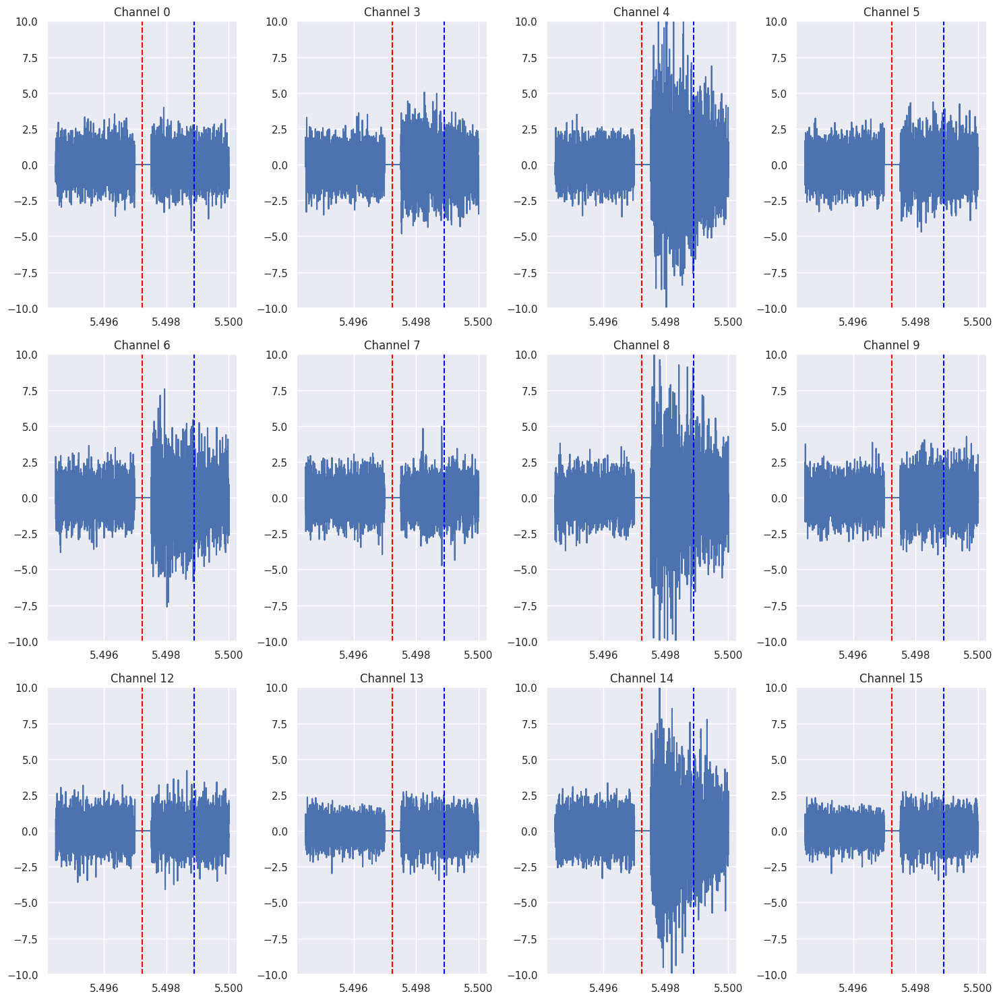

<Figure size 640x480 with 0 Axes>

In [ ]:
# @title do an example plot around one of the stimuli
num_rows = 3
num_cols = 4

a = stims_ind[0,0] - 5000
b = stims_ind[0,1] + 5000
## Window that we show is between the red line and blue line
window_sec = .1

time = np.array(range(a, b)) / fs / 60

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, 15))
for i in range(dat.shape[1]):
    row = i // num_cols
    col = i % num_cols
    axes[row, col].plot(time, dat[a : b, i])
    axes[row, col].set_ylim(-10, 10)
    axes[row, col].set_title(f'Channel {channel_mapping[i]}')
    axes[row, col].axvline(x=stims_min[0,0], color='green', linestyle='--')  # Add vertical line
    axes[row, col].axvline(x=stims_min[0,1], color='red', linestyle='--')  # Add vertical line
    axes[row, col].axvline(x=stims_min[0,1] + window_sec /60, color='blue', linestyle='--')  # Add vertical line




plt.tight_layout()
plt.show()

plt.tight_layout()
plt.show()

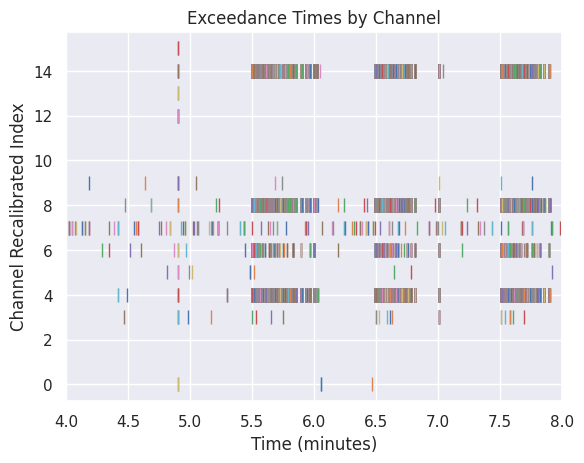

In [ ]:
# @title do a raster plot
threshold = 5
exceedance_times = []

for i in range(dat.shape[1]):
    exceedance_times.append( np.array(np.where(abs(dat[:,i]) > threshold)) / fs / 60 )

for i in range(12):
    x = exceedance_times[i]
    j = channel_mapping[i]
    plt.plot(x, [j] * len(x), '|', markersize=10)

plt.xlim(4, 8)
plt.xlabel("Time (minutes)")
plt.ylabel("Channel Recalibrated Index")
plt.title("Exceedance Times by Channel")
plt.show()

In [ ]:
#@title Look at the response right around the first stimulus
#stims_ind[0,1] is where the stimulus ended

a = stims_ind[0,1]
b = a + int(window_sec * fs)
subdat = (dat[ a : b , :] >= threshold) * 1

Defining the values to plot is basically the sum of the exceedances above the threshold in the window after the stimulus.  We also take the log since the values are so high for some of the channels and 0 for others. But, since they are exactly 0 we take the log + 1.

In [ ]:
# @title defining the values to plot
v = np.log(subdat.sum(0) + 1)
v

array([0.        , 0.69314718, 5.06259503, 0.        , 3.13549422,
       0.        , 5.0369526 , 0.        , 0.        , 0.        ,
       4.7095302 , 0.        ])

In [ ]:
# @title set the 3d data and defaults that define the plot
# set up the data
keep_channels = channel_mapping
west_x = [-0.773, -0.812, -0.665, -0.812]
west_y = [ 0.000,  0.564,  0.000, -0.564]
west_z = [ 0.635, -0.149, -0.747, -0.149]

east_x = [ 0.773, 0.812, 0.665, 0.812]
east_y = [ 0.000,-0.564, 0.000, 0.564]
east_z = [ 0.635,-0.149,-0.747,-0.149]

north_x = [ 0.000, 0.564, 0.000,-0.564]
north_y = [ 0.773, 0.812, 0.665, 0.812]
north_z = [ 0.635,-0.149,-0.747,-0.149]

south_x = [ 0.000,-0.564, 0.000, 0.564]
south_y = [-0.773,-0.812,-0.665,-0.812]
south_z = [ 0.635,-0.149,-0.747,-0.149]

xx = np.array(west_x + east_x + north_x + south_x)
xy = np.array(west_y + east_y + north_y + south_y)
xz = np.array(west_z + east_z + north_z + south_z)

xx_all = xx.copy()
xy_all = xy.copy()
xz_all = xz.copy()

xx = xx[keep_channels]
xy = xy[keep_channels]
xz = xz[keep_channels]

n_grid = 1000
theta, phi = np.linspace(0, 2*np.pi, n_grid), np.linspace(0, np.pi, 100)
theta, phi = np.meshgrid(theta, phi)

zx_surface = np.cos(theta) * np.sin(phi)
zy_surface = np.sin(theta) * np.sin(phi)
zz_surface = np.cos(phi)

n1, n2 = zx_surface.shape
sigma = 0.2




In [ ]:
# @title create the surface data to be plotted
ivals = np.empty([n1, n2])
for i in range(n1):
    for j in range(n2):
        loc = [zx_surface[i,j], zy_surface[i,j], zz_surface[i,j]]
        w = 0
        ## exp(-distance) = idistance
        ## sum exp(-distance) = total_idistance
        total_idistance = 0
        for k in range(len(xx)):
            x = [xx[k], xy[k], xz[k]]
            ## Use a Gaussian kernel to smooth
            angle = np.dot(x, loc)
            ## This prevents a numerical error since a very small value
            ## above or below 1 is outside of the domain of arccos
            if angle > 1:
                angle = 1
            elif angle < -1:
                angle = -1

            d = np.exp(-np.arccos( angle ) / 2 / sigma ** 2)
            w +=  d * v[k]
            total_idistance += d
        w /= total_idistance
        ivals[i,j] = w


In [ ]:
#@title create the plot
#channel_mapping_str = [str(x) for x in channel_mapping]
## Note we're putting all of the labels on for this plot
channel_mapping_str = [str(x) for x in range(16)]

## Get the interpoplated data
fudge = 1.05
fudge2 = 1.2
fig = go.Figure(data = [
        go.Surface(x = zx_surface , y = zy_surface , z = zz_surface, surfacecolor = ivals, cmin = 0, cmax = 6),
## Use this if you want only the points used in the smoothing
##        go.Scatter3d(x = xx * fudge, y = xy * fudge, z = xz * fudge,
        ## Use this if you want all points (but the smoothing only uses the valid electrodes)
        go.Scatter3d(x = xx_all * fudge, y = xy_all * fudge, z = xz_all * fudge,
                mode ='markers',
                marker=dict(size=10, color='black'),
                     showlegend=False
                ),
        go.Scatter3d(x = xx_all * fudge2, y = xy_all * fudge2, z = xz_all * fudge2,
                mode ='text',
                text = channel_mapping_str,
                textposition='top center',
                     showlegend=False
                )

        ]
    )

fig.update_layout(scene=dict(
    xaxis=dict(showbackground=False, showticklabels=False, title=''),
    yaxis=dict(showbackground=False, showticklabels=False, title=''),
    zaxis=dict(showbackground=False, showticklabels=False, title='')
    )
)
fig.update_layout(width=800, height=800)


In [ ]:
#@title create the plot
#channel_mapping_str = [str(x) for x in channel_mapping]
## Note we're putting all of the labels on for this plot
channel_mapping_str = [str(x) for x in range(16)]

## Get the interpoplated data
fudge = 1.05
fudge2 = 1.2
fig = go.Figure(data = [
        go.Surface(x = zx_surface , y = zy_surface , z = zz_surface, surfacecolor = ivals, cmin = 0, cmax = 6),
## Use this if you want only the points used in the smoothing
##        go.Scatter3d(x = xx * fudge, y = xy * fudge, z = xz * fudge,
        ## Use this if you want all points (but the smoothing only uses the valid electrodes)
        go.Scatter3d(x = xx_all * fudge, y = xy_all * fudge, z = xz_all * fudge,
                mode ='markers',
                marker=dict(size=10, color='white'),
                     showlegend=False
                ),
        go.Scatter3d(x = xx_all * fudge2, y = xy_all * fudge2, z = xz_all * fudge2,
                mode ='text',
                text = channel_mapping_str,
                textposition='top center',
                     showlegend=False
                )

        ]
    )

fig.update_layout(scene=dict(
    xaxis=dict(showbackground=False, showticklabels=False, title=''),
    yaxis=dict(showbackground=False, showticklabels=False, title=''),
    zaxis=dict(showbackground=False, showticklabels=False, title='')
    )
)
fig.update_layout(width=800, height=800)


In [ ]:
#@title adding the arc lengths of where the channels are measured
def draw_arc(point1, point2, num_points=50):
  """Draws an arc between two points on the unit sphere.

  Args:
    point1: Tuple (x, y, z) representing the first point.
    point2: Tuple (x, y, z) representing the second point.
    num_points: The number of points to interpolate along the arc.

  Returns:
    A Plotly Scatter3d trace representing the arc.
  """

  # Convert points to numpy arrays
  p1 = np.array(point1)
  p2 = np.array(point2)

  # Calculate the angle between the two points
  theta = np.arccos(np.dot(p1, p2))

  # Interpolate points along the arc
  t = np.linspace(0, 1, num_points)
  arc_points = np.array([
      (np.sin((1 - t_i) * theta) * p1[i] + np.sin(t_i * theta) * p2[i]) / np.sin(theta)
      for i in range(3) for t_i in t
  ]).reshape(3, num_points)

  # Create the Scatter3d trace
  arc_trace = go.Scatter3d(
      x=arc_points[0],
      y=arc_points[1],
      z=arc_points[2],
      mode='lines',
      line=dict(color='white', width=5),
      showlegend=False# Customize line style
  )

  return arc_trace

In [ ]:
arc_trace = draw_arc( (0, 0, -1),  (xx_all[0], xy_all[0], xz_all[0]))
fig.add_trace(arc_trace)
arc_trace = draw_arc(
    (xx_all[3], xy_all[3], xz_all[3]),
    (xx_all[1], xy_all[1], xz_all[1])
    )
fig.add_trace(arc_trace)


arc_trace = draw_arc( (0, 0, -1),  (xx_all[0], xy_all[0], xz_all[0]))
fig.add_trace(arc_trace)
arc_trace = draw_arc(
    (xx_all[3], xy_all[3], xz_all[3]),
    (xx_all[1], xy_all[1], xz_all[1])
    )
fig.add_trace(arc_trace)

arc_trace = draw_arc( (0, 0, -1),  (xx_all[4], xy_all[4], xz_all[4]))
fig.add_trace(arc_trace)
arc_trace = draw_arc(
    (xx_all[7], xy_all[7], xz_all[7]),
    (xx_all[5], xy_all[5], xz_all[5])
    )
fig.add_trace(arc_trace)


arc_trace = draw_arc( (0, 0, -1),  (xx_all[8], xy_all[8], xz_all[8]))
fig.add_trace(arc_trace)
arc_trace = draw_arc(
    (xx_all[11], xy_all[11], xz_all[11]),
    (xx_all[9], xy_all[9], xz_all[9])
    )
fig.add_trace(arc_trace)



arc_trace = draw_arc( (0, 0, -1),  (xx_all[12], xy_all[12], xz_all[12]))
fig.add_trace(arc_trace)
arc_trace = draw_arc(
    (xx_all[15], xy_all[15], xz_all[15]),
    (xx_all[13], xy_all[13], xz_all[13])
    )
fig.add_trace(arc_trace)


## Add the leaf for 4-7
fig.add_trace(go.Scatter3d(x=[0, (386.3/2+597.4) / 350], y=[0, 0], z=[-1, -1], mode='lines', line=dict(color='black', width=3), showlegend=False))
fig.add_trace(go.Scatter3d(x=[(386.3/2+304.4) / 350, (386.3/2+304.4) / 350], y=[-215/350, 215/350], z=[-1, -1], mode='lines', line=dict(color='black', width=3),showlegend=False))
## Add the labels and markers for the [0-3] indices
fig.add_trace(go.Scatter3d(x=[254.55 / 350], y=[0], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="6", showlegend=False))
fig.add_trace(go.Scatter3d(x=[(386.3/2+597.4) / 350], y=[0], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="4", showlegend=False))
fig.add_trace(go.Scatter3d(x=[(386.3/2+304.4) / 350], y=[215/350], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="7", showlegend=False))
fig.add_trace(go.Scatter3d(x=[(386.3/2+304.4) / 350], y=[-215/350], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="5", showlegend=False))


## Add the leaf for 0-3
fig.add_trace(go.Scatter3d(x=[0, -(386.3/2+597.4) / 350], y=[0, 0], z=[-1, -1], mode='lines', line=dict(color='black', width=3), showlegend=False))
fig.add_trace(go.Scatter3d(x=[-(386.3/2+304.4) / 350, -(386.3/2+304.4) / 350], y=[-215/350, 215/350], z=[-1, -1], mode='lines', line=dict(color='black', width=3),showlegend=False))
## Add the labels and markers for the [0-3] indices
fig.add_trace(go.Scatter3d(x=[-254.55 / 350], y=[0], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="2", showlegend=False))
fig.add_trace(go.Scatter3d(x=[-(386.3/2+597.4) / 350], y=[0], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="0", showlegend=False))
fig.add_trace(go.Scatter3d(x=[-(386.3/2+304.4) / 350], y=[215/350], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="1", showlegend=False))
fig.add_trace(go.Scatter3d(x=[-(386.3/2+304.4) / 350], y=[-215/350], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="3", showlegend=False))



## Add the two lines, for the [0-3] indices
fig.add_trace(go.Scatter3d(y=[0, -(386.3/2+597.4) / 350], x=[0, 0], z=[-1, -1], mode='lines', line=dict(color='black', width=3), showlegend=False))
fig.add_trace(go.Scatter3d(y=[-(386.3/2+304.4) / 350, -(386.3/2+304.4) / 350], x=[-215/350, 215/350], z=[-1, -1], mode='lines', line=dict(color='black', width=3),showlegend=False))
## Add the labels and markers for the [0-3] indices
fig.add_trace(go.Scatter3d(y=[-254.55 / 350], x=[0], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="14", showlegend=False))
fig.add_trace(go.Scatter3d(y=[-(386.3/2+597.4) / 350], x=[0], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="12", showlegend=False))
fig.add_trace(go.Scatter3d(y=[-(386.3/2+304.4) / 350], x=[215/350], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="15", showlegend=False))
fig.add_trace(go.Scatter3d(y=[-(386.3/2+304.4) / 350], x=[-215/350], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="13", showlegend=False))


## Add the leaf for 4-7
fig.add_trace(go.Scatter3d(y=[0, (386.3/2+597.4) / 350], x=[0, 0], z=[-1, -1], mode='lines', line=dict(color='black', width=3), showlegend=False))
fig.add_trace(go.Scatter3d(y=[(386.3/2+304.4) / 350, (386.3/2+304.4) / 350], x=[-215/350, 215/350], z=[-1, -1], mode='lines', line=dict(color='black', width=3),showlegend=False))
## Add the labels and markers for the [0-3] indices
fig.add_trace(go.Scatter3d(y=[254.55 / 350], x=[0], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="10", showlegend=False))
fig.add_trace(go.Scatter3d(y=[(386.3/2+597.4) / 350], x=[0], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="8", showlegend=False))
fig.add_trace(go.Scatter3d(y=[(386.3/2+304.4) / 350], x=[215/350], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="9", showlegend=False))
fig.add_trace(go.Scatter3d(y=[(386.3/2+304.4) / 350], x=[-215/350], z=[-1], mode='markers+text', marker=dict(size=5, color='black'), text="11", showlegend=False))




fig.show()

## Create the movie

The first step in the movie is to create a series of bins

In [ ]:
# @title This redefines subdat into the range you're interested in
a = int(4 * fs * 60)
b = int(8 * fs * 60)

## Calculate the data above the thrshold
subdat = (dat[ a : b , :] >= threshold) * 1

# break the data into counts within bins
bin_size = int(5 * fs)  # Samples
no_bins = int(subdat.shape[0] / bin_size)

exceedance_count = np.empty([no_bins, subdat.shape[1]])

for i in range(subdat.shape[1]):
    for j in range(no_bins):
        bin_start = j * bin_size
        bin_end = (j + 1) * bin_size
        exceedance_count[j, i] = np.sum(subdat[bin_start : bin_end, i])

bin_centers_min = np.arange(no_bins) * bin_size / fs / 60 + a / fs / 60

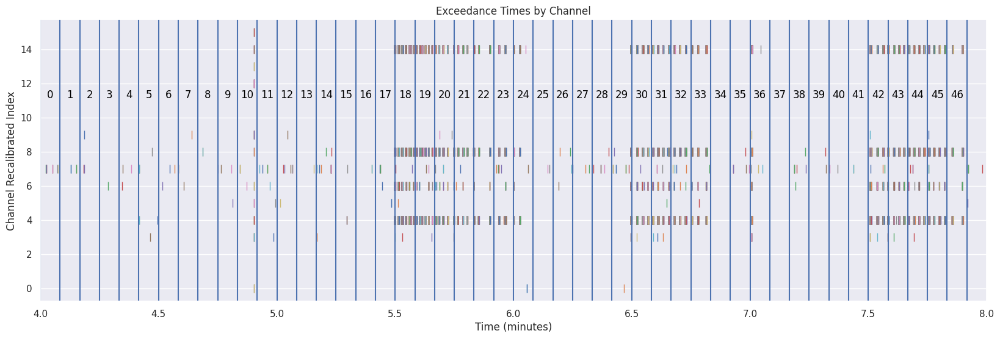

In [ ]:
# @title do a raster plot
import matplotlib.pyplot as plt

#plt.figure(figsize=(20, 6))  # Increased width to 20 inches
fig, ax1 = plt.subplots(figsize=(20, 6))  # Increased width to 20 inches

for i in range(12):
    x = exceedance_times[i]
    j = channel_mapping[i]
    #plt.plot(x, [j] * len(x), '|', markersize=10)
    ax1.plot(x, [j] * len(x), '|', markersize=10)


for i in range(no_bins):
    #plt.axvline(x = bin_centers_min[i])
    ax1.axvline(x=bin_centers_min[i])
    if i < no_bins - 1:
        ax1.text(bin_centers_min[i] * 0.5  + bin_centers_min[i+1] * 0.5, 11 , f'{i}', ha='center', va='bottom', color='black')  # Adjust position and color as needed


plt.xlim(4, 8)
plt.xlabel("Time (minutes)")
plt.ylabel("Channel Recalibrated Index")
plt.title("Exceedance Times by Channel")
plt.show()

In [ ]:
# @title Generate the movie
import os
import imageio

os.chdir("../data/oi/movie_frames/")

# Create a directory to store the snapshots
output_dir = "movie_frames"
os.makedirs(output_dir, exist_ok=True)

# Loop through the desired index range
for index in range(exceedance_count.shape[0]):
    # Update the data in your Plotly figure for the current index
    v = np.log(exceedance_count[index, :].flatten() + 1)
    ivals = np.empty([n1, n2])

    for i in range(n1):
        for j in range(n2):

            loc = [zx_surface[i,j], zy_surface[i,j], zz_surface[i,j]]
            w = 0
            total_idistance = 0

            for k in range(len(xx)):
                x = [xx[k], xy[k], xz[k]]
                angle = np.dot(x, loc)
                ## This prevents a numerical error since a very small value
                ## above or below 1 is outside of the domain of arccos
                if angle > 1:
                    angle = 1
                elif angle < -1:
                    angle = -1

                d = np.exp(-np.arccos( angle ) / 2 / sigma ** 2)
                w +=  d * v[k]
                total_idistance += d

            w /= total_idistance
            ivals[i,j] = w

    fig = go.Figure(data = [
            go.Surface(x = zx_surface , y = zy_surface , z = zz_surface, surfacecolor = ivals, cmin = 0, cmax = 6, showscale = False),
        ]
    )
    fig.update_layout(scene=dict(
        xaxis=dict(showbackground=False, showticklabels=False, title=''),
        yaxis=dict(showbackground=False, showticklabels=False, title=''),
        zaxis=dict(showbackground=False, showticklabels=False, title=''),
        )
    )
    fig.update_layout(width=800, height=800, margin=dict(l=0, r=0, b=0, t=0))

    #fig.data[0].surfacecolor = ivals
    fig.update_layout(title=f"Frame {index}")  # Add a title for each frame

    ## Change the layout
    fig.update_layout(scene_camera=dict(eye=dict(x=np.cos(np.pi/4), y=np.sin(np.pi/4))))

    # Save the current frame as a PNG image
    filename = os.path.join(output_dir, f"frame_{index:04d}.png")
    fig.write_image(filename)


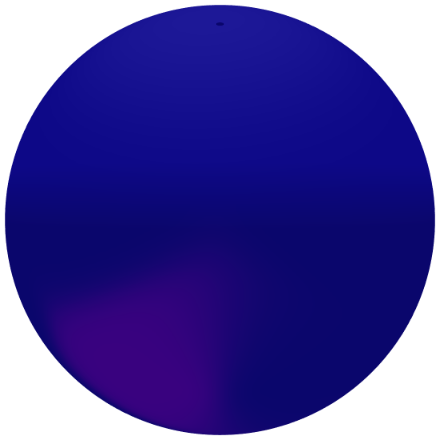

In [ ]:
from PIL import Image


image = Image.open("movie_frames/frame_0000.png")

left = 180  # x-coordinate of the left edge
right = 620 # x-coordinate of the right edge
upper = 180   # y-coordinate of the upper edge
lower = 620  # y-coordinate of the lower edge

# Create a cropping box tuple
box = (left, upper, right, lower)

cropped_image = image.crop(box)
cropped_image


In [ ]:
## Load the images
frames = os.listdir("movie_frames")

images = []
for filename in os.listdir("movie_frames"):
    if filename.endswith(".png"):
        filepath = os.path.join("movie_frames", filename)
        image = Image.open(filepath)
        images.append(np.array(image))


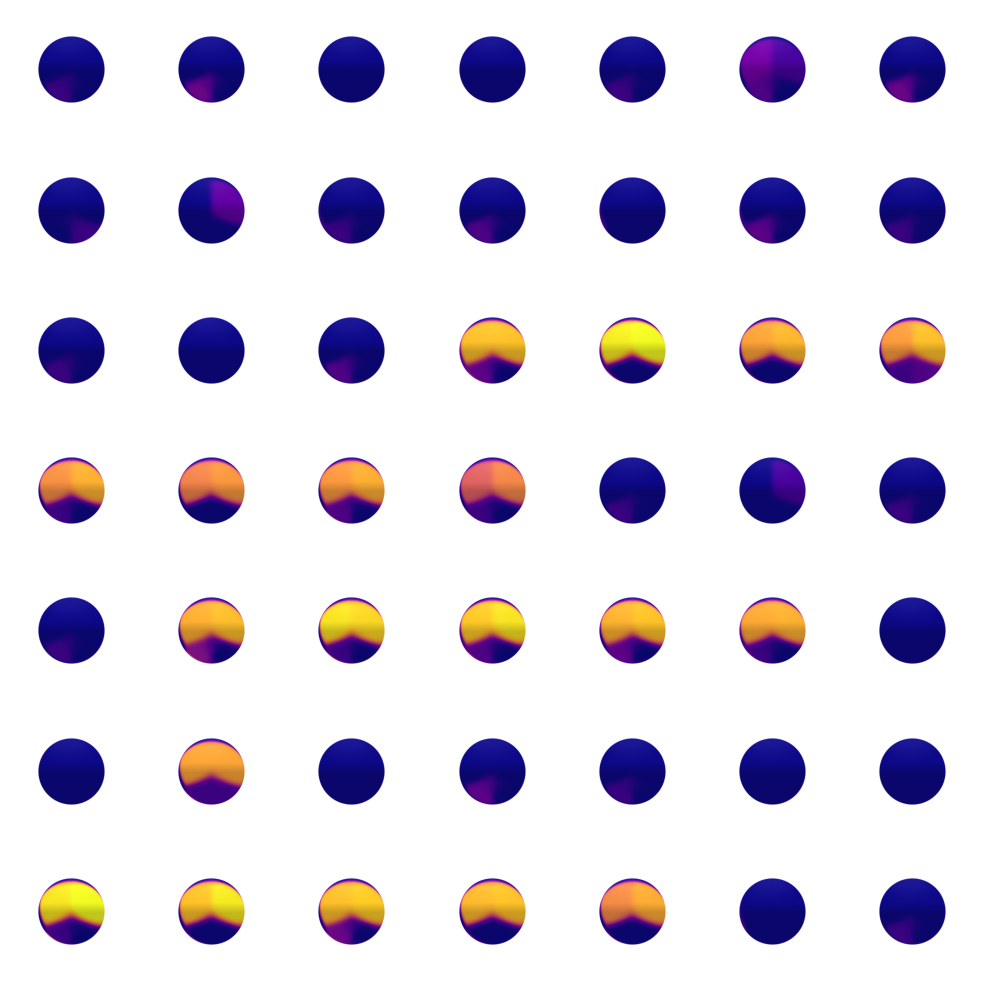

In [ ]:
# Determine the number of images
num_images = len(images)

# Calculate the dimensions of the 7x7 grid
num_rows = 7
num_cols = 7

# Create a figure and axes for the grid
fig, axes = plt.subplots(num_rows, num_cols, figsize=(10, 10))  # Adjust figsize as needed

# Flatten the axes array for easier indexing
axes = axes.ravel()

# Loop through the images and plot them on the grid
for i in range(num_images):
    axes[i].imshow(images[i], cmap='gray')  # Adjust cmap if needed
    axes[i].axis('off')  # Turn off axis labels and ticks

# Hide any unused subplots (if num_images < 49)
for i in range(num_images, num_rows * num_cols):
    axes[i].axis('off')

plt.tight_layout()  # Adjust subplot spacing
plt.show()